In [77]:
source('util.r')
library(plotly)
library(pracma)
#Model 1 as base line - blindly buy SP 500, check the daily average:
stock_names <- unlist(lapply(list.files('./data'), function(x) gsub(".rds", "", x)))


In [78]:
length(stock_names)

[1] 502

In [2]:

ewma <- function (x, alpha) {
  c(stats::filter(x * alpha, 1 - alpha, "recursive", init = x[1]))
}

ewmsd <- function(x, alpha) {
  sqerror <- na.omit((x - lag(ewma(x, alpha)))^2)
  ewmvar <- c(stats::filter(sqerror * alpha, 1 - alpha, "recursive", init = 0))
  c(NA, sqrt(ewmvar))
}

#https://stackoverflow.com/questions/54585015/vectorized-implementation-of-exponentially-weighted-moving-standard-deviation-us
ewmsd2 <- function(x, alpha) {
  n <- length(x)
  sapply(
    1:n,
    function(i, x, alpha) {
      y <- x[1:i]
      m <- length(y)
      weights <- (1 - alpha)^((m - 1):0)
      #print(weights)
      ewma <- sum(weights * y) / sum(weights)

      bias <- sum(weights)^2 / (sum(weights)^2 - sum(weights^2))
      ewmsd <- sqrt(bias * sum(weights * (y - ewma)^2) / sum(weights))
    },
    x = x,
    alpha = alpha
  )
}

n=20
alpha <- 2/(n+1)
#ewmsd(x = 0:9, alpha = alpha)
ewmsd2(x = 0:9, alpha = alpha)



#ewma(x = 0:9, alpha = 2/(n+1))
#movavg(x = 0:9, n=2, type='e')

[1]        NA 0.0000000 0.2792156 0.5944656 0.9476005 1.3220829 1.7069994
 [8] 2.0948055 2.4801322 2.8591062 3.2289280

[1]       NaN 0.7071068 0.9991670 1.2882030 1.5748410 1.8590624 2.1406462
 [8] 2.4192974 2.6946946 2.9665114

In [37]:
helper <- function(all, name) {
  #df <- data_prep(name, to_sek=FALSE) %>% select(no_model_profit)
  df <- data_prep(name, end_date=NULL, to_sek=FALSE, reload=TRUE) %>% mutate(mean_diff=c(0, diff(mean))) %>% select(mean_diff, no_model_profit)
  n <- 20
  alpha <- 2/(n+1)
  df$movavg <- ewma(df$mean_diff, alpha)
  df$movsd <- ewmsd2(df$mean_diff, alpha)
  
  movavg_diff_volume <- ewma(df$mean_diff * df$volume, alpha)
  movavg_volume <- ewma(df$volume, alpha)
  df$movavg_v <- movavg_diff_volume / movavg_volume
  

  df <- df %>% filter(!is.na(movavg)) %>% filter(!is.na(movsd)) %>% mutate(mov_mu_sd_ratio=movavg/movsd)
  colnames(df) <- paste(name, colnames(df), sep='.')
  merge_with_rowname(all, df)
}

#high_weight <- c('AAPL', 'MSFT', 'AMZN', 'TSLA', 'UNH', 'GOOGL', 'XOM', 'JNJ', 'GOOG', 'JPM', 'NVDA', 'CVX', 'V', 'PG', 'HD', 'LLY', 'MA', 'PFE', 'ABBV', 'BAC', 'MRK', 'PEP', 'KO', 'COST', 'META', 'MCD', 'WMT', 'TMO', 'CSCO', 'DIS', 'AVGO', 'WFC', 'COP', 'ABT', 'BMY', 'ACN', 'DHR', 'VZ', 'NEE', 'LIN', 'CRM', 'TXN', 'AMGN', 'RTX', 'HON', 'PM', 'ADBE', 'CMCSA', 'T')
#stock_names <- high_weight
m <- Reduce(helper, stock_names, init=NULL)

Warning message:
“LUV contains missing values. Some functions will not work if objects contain missing values in the middle of the series. Consider using na.omit(), na.approx(), na.fill(), etc to remove or replace them.”
Warning message:
“PPL contains missing values. Some functions will not work if objects contain missing values in the middle of the series. Consider using na.omit(), na.approx(), na.fill(), etc to remove or replace them.”
Warning message:
“T contains missing values. Some functions will not work if objects contain missing values in the middle of the series. Consider using na.omit(), na.approx(), na.fill(), etc to remove or replace them.”
Warning message:
“TXN contains missing values. Some functions will not work if objects contain missing values in the middle of the series. Consider using na.omit(), na.approx(), na.fill(), etc to remove or replace them.”
Warning message:
“ULTA contains missing values. Some functions will not work if objects contain missing values in the 

In [38]:
data_prep('T', end_date=NULL, to_sek=FALSE, reload=TRUE) %>% mutate(mean_diff=c(0, diff(mean))) %>% select(mean_diff, no_model_profit)

Warning message:
“T contains missing values. Some functions will not work if objects contain missing values in the middle of the series. Consider using na.omit(), na.approx(), na.fill(), etc to remove or replace them.”


,mean_diff,no_model_profit
,<dbl>,<dbl>
2007-01-03,0.0000000000,0.000000000
2007-01-04,-0.0178742580,-0.012959177
2007-01-05,-0.0119014595,-0.015775924
2007-01-08,-0.0187168978,-0.004426743
2007-01-09,0.0125657465,0.003837592
2007-01-10,-0.0167398856,0.002648235
2007-01-11,0.0174741860,0.013426937
2007-01-12,0.0176068324,0.006934406
2007-01-16,0.0008650859,-0.002883520


In [41]:
tail(m)

,A.mean_diff,A.no_model_profit,A.movavg,A.movsd,A.mov_mu_sd_ratio,AAL.mean_diff,AAL.no_model_profit,AAL.movavg,AAL.movsd,AAL.mov_mu_sd_ratio,⋯,ZION.mean_diff,ZION.no_model_profit,ZION.movavg,ZION.movsd,ZION.mov_mu_sd_ratio,ZTS.mean_diff,ZTS.no_model_profit,ZTS.movavg,ZTS.movsd,ZTS.mov_mu_sd_ratio
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2022-11-25,0.000128378,0.010310366,0.007947360,0.02197937,0.3615826,0.025803384,0.0055325176,2.945317e-03,0.02553347,0.115351196,⋯,0.003605031,0.004454350,6.643913e-05,0.02260979,0.002938511,-0.0002670829,-0.002461957,0.0024933730,0.02939001,0.08483744
2022-11-28,-0.009963845,-0.030138761,0.006241531,0.02159126,0.2890767,-0.027571106,-0.0473085037,3.899068e-05,0.02596795,0.001501493,⋯,-0.009282396,-0.029811974,-8.239261e-04,0.02168973,-0.037986926,-0.0056922872,-0.013211478,0.0017137863,0.02806396,0.06106715
2022-11-29,-0.016962032,-0.008969859,0.004031667,0.02169376,0.1858446,-0.009600074,0.0221675148,-8.790155e-04,0.02487045,-0.035343768,⋯,-0.006401105,0.015801218,-1.355086e-03,0.02069931,-0.065465276,-0.0068061990,-0.001892013,0.0009023591,0.02681720,0.03364853
2022-11-30,0.002271728,0.026413630,0.003864054,0.02064169,0.1871966,0.013837368,0.0203017123,5.225449e-04,0.02406812,0.021711078,⋯,0.002466793,0.015362500,-9.910976e-04,0.01972259,-0.050251903,0.0177932821,0.041662987,0.0025110184,0.02601054,0.09653850
2022-12-01,0.023819550,0.007328860,0.005764578,0.02053339,0.2807416,0.004219416,-0.0316816360,8.746278e-04,0.02292041,0.038159346,⋯,0.022220991,0.003275256,1.219577e-03,0.02002013,0.060917566,0.0378990113,0.016088899,0.0058813035,0.02693888,0.21832027
2022-12-02,-0.003506384,-0.002886541,0.004881629,0.01972972,0.2474251,-0.030278359,-0.0007155635,-2.092323e-03,0.02373479,-0.088154279,⋯,-0.003379187,0.004988460,7.815999e-04,0.01909324,0.040935948,-0.0077364333,0.004967208,0.0045843762,0.02595012,0.17666106


In [70]:
list_ <- unlist(tail(m %>% select(contains('.mov_mu_sd_ratio')), n=1))
candidates <- gsub('.mov_mu_sd_ratio', '', names(sort(list_)[1:10]))

In [71]:
list_[which.max(list_)]
list_[which.min(list_)]

PM.mov_mu_sd_ratio 
          0.648304

ADM.mov_mu_sd_ratio 
         -0.2671334

In [72]:
results <- readRDS(file="new_parameters_results.rds")

In [73]:
stock_names

[1] "A"     "AAL"   "AAP"   "AAPL"  "ABBV"  "ABC"   "ABMD"  "ABT"   "ACGL" 
 [10] "ACN"   "ADBE"  "ADI"   "ADM"   "ADP"   "ADSK"  "AEE"   "AEP"   "AES"  
 [19] "AFL"   "AIG"   "AIZ"   "AJG"   "AKAM"  "ALB"   "ALGN"  "ALK"   "ALL"  
 [28] "ALLE"  "AMAT"  "AMCR"  "AMD"   "AME"   "AMGN"  "AMP"   "AMT"   "AMZN" 
 [37] "ANET"  "ANSS"  "AON"   "AOS"   "APA"   "APD"   "APH"   "APTV"  "ARE"  
 [46] "ATO"   "ATVI"  "AVB"   "AVGO"  "AVY"   "AWK"   "AXP"   "AZO"   "BA"   
 [55] "BAC"   "BALL"  "BAX"   "BBWI"  "BBY"   "BDX"   "BEN"   "BIIB"  "BIO"  
 [64] "BK"    "BKNG"  "BKR"   "BLK"   "BMY"   "BR"    "BRO"   "BSX"   "BWA"  
 [73] "BXP"   "C"     "CAG"   "CAH"   "CARR"  "CAT"   "CB"    "CBOE"  "CBRE" 
 [82] "CCI"   "CCL"   "CDAY"  "CDNS"  "CDW"   "CE"    "CEG"   "CF"    "CFG"  
 [91] "CHD"   "CHRW"  "CHTR"  "CI"    "CINF"  "CL"    "CLX"   "CMA"   "CMCSA"
[100] "CME"   "CMG"   "CMI"   "CMS"   "CNC"   "CNP"   "COF"   "COO"   "COP"  
[109] "COST"  "CPB"   "CPRT"  "CPT"   "CRL"   "CRM"   "CSCO"  "CSGP"  "CSX"  
[118] "CTAS"  "CTLT"  "CTRA"  "CTSH"  "CTVA"  "CVS"   "CVX"   "CZR"   "D"    
[127] "DAL"   "DD"    "DE"    "DFS"   "DG"    "DGX"   "DHI"   "DHR"   "DIS"  
[136] "DISH"  "DLR"   "DLTR"  "DOV"   "DOW"   "DPZ"   "DRI"   "DTE"   "DUK"  
[145] "DVA"   "DVN"   "DXC"   "DXCM"  "EA"    "EBAY"  "ECL"   "ED"    "EFX"  
[154] "EIX"   "EL"    "ELV"   "EMN"   "EMR"   "ENPH"  "EOG"   "EPAM"  "EQIX" 
[163] "EQR"   "EQT"   "ES"    "ESS"   "ETN"   "ETR"   "ETSY"  "EVRG"  "EW"   
[172] "EXC"   "EXPD"  "EXPE"  "EXR"   "F"     "FANG"  "FAST"  "FBHS"  "FCX"  
[181] "FDS"   "FDX"   "FE"    "FFIV"  "FIS"   "FISV"  "FITB"  "FLT"   "FMC"  
[190] "FOX"   "FOXA"  "FRC"   "FRT"   "FTNT"  "FTV"   "GD"    "GE"    "GEN"  
[199] "GILD"  "GIS"   "GL"    "GLW"   "GM"    "GNRC"  "GOOG"  "GOOGL" "GPC"  
[208] "GPN"   "GRMN"  "GS"    "GWW"   "HAL"   "HAS"   "HBAN"  "HCA"   "HD"   
[217] "HES"   "HIG"   "HII"   "HLT"   "HOLX"  "HON"   "HPE"   "HPQ"   "HRL"  
[226] "HSIC"  "HST"   "HSY"   "HUM"   "HWM"   "IBM"   "ICE"   "IDXX"  "IEX"  
[235] "IFF"   "ILMN"  "INCY"  "INTC"  "INTU"  "INVH"  "IP"    "IPG"   "IQV"  
[244] "IR"    "IRM"   "ISRG"  "IT"    "ITW"   "IVZ"   "J"     "JBHT"  "JCI"  
[253] "JKHY"  "JNJ"   "JNPR"  "JPM"   "K"     "KDP"   "KEY"   "KEYS"  "KHC"  
[262] "KIM"   "KLAC"  "KMB"   "KMI"   "KMX"   "KO"    "KR"    "L"     "LDOS" 
[271] "LEN"   "LH"    "LHX"   "LIN"   "LKQ"   "LLY"   "LMT"   "LNC"   "LNT"  
[280] "LOW"   "LRCX"  "LUMN"  "LUV"   "LVS"   "LW"    "LYB"   "LYV"   "MA"   
[289] "MAA"   "MAR"   "MAS"   "MCD"   "MCHP"  "MCK"   "MCO"   "MDLZ"  "MDT"  
[298] "MET"   "META"  "MGM"   "MHK"   "MKC"   "MKTX"  "MLM"   "MMC"   "MMM"  
[307] "MNST"  "MO"    "MOH"   "MOS"   "MPC"   "MPWR"  "MRK"   "MRNA"  "MRO"  
[316] "MS"    "MSCI"  "MSFT"  "MSI"   "MTB"   "MTCH"  "MTD"   "MU"    "NCLH" 
[325] "NDAQ"  "NDSN"  "NEE"   "NEM"   "NFLX"  "NI"    "NKE"   "NLOK"  "NOC"  
[334] "NOW"   "NRG"   "NSC"   "NTAP"  "NTRS"  "NUE"   "NVDA"  "NVR"   "NWL"  
[343] "NWS"   "NWSA"  "NXPI"  "O"     "ODFL"  "OGN"   "OKE"   "OMC"   "ON"   
[352] "ORCL"  "ORLY"  "OTIS"  "OXY"   "PARA"  "PAYC"  "PAYX"  "PCAR"  "PCG"  
[361] "PEAK"  "PEG"   "PEP"   "PFE"   "PFG"   "PG"    "PGR"   "PH"    "PHM"  
[370] "PKG"   "PKI"   "PLD"   "PM"    "PNC"   "PNR"   "PNW"   "POOL"  "PPG"  
[379] "PPL"   "PRU"   "PSA"   "PSX"   "PTC"   "PWR"   "PXD"   "PYPL"  "QCOM" 
[388] "QRVO"  "RCL"   "RE"    "REG"   "REGN"  "RF"    "RHI"   "RJF"   "RL"   
[397] "RMD"   "ROK"   "ROL"   "ROP"   "ROST"  "RSG"   "RTX"   "SBAC"  "SBNY" 
[406] "SBUX"  "SCHW"  "SEDG"  "SEE"   "SHW"   "SIVB"  "SJM"   "SLB"   "SNA"  
[415] "SNPS"  "SO"    "SPG"   "SPGI"  "SRE"   "STE"   "STT"   "STX"   "STZ"  
[424] "SWK"   "SWKS"  "SYF"   "SYK"   "SYY"   "T"     "TAP"   "TDG"   "TDY"  
[433] "TECH"  "TEL"   "TER"   "TFC"   "TFX"   "TGT"   "TJX"   "TMO"   "TMUS" 
[442] "TPR"   "TRGP"  "TRMB"  "TROW"  "TRV"   "TSCO"  "TSLA"  "TSN"   "TT"   
[451] "TTWO"  "TXN"   "TXT"   "TYL"   "UAL"   "UDR"   "UHS"   "ULTA"  "UNH"  
[460] "UNP"   "UPS"   "U

In [74]:
candidates_index <- match(candidates, stock_names)

In [75]:
candidates

[1] "ADM"  "LUMN" "BAX"  "PYPL" "COST" "FANG" "NTAP" "DG"   "NWL"  "AAP"

In [76]:
par_results <- results[candidates_index]
r <- do.call(rbind, par_results)
profits <- unlist(r[,2])
candidates[profits < -2]

[1] "COST" "FANG" "DG"   "AAP"

In [32]:
length(results)

[1] 502

In [33]:
length(list_)

[1] 49

In [6]:
# two conditions:
# 1. mov_mu_sd_ratio is increasing
# 2. mov_mu_sd_ratio is minimal
func_select <- function(x, stock_list) {
    min <- 999
    selected <- NA
    for (idx in seq_along(stock_list)) {
        stock <- stock_list[idx]
        r <- paste0(stock, '.', 'mov_mu_sd_ratio')
        dr <- paste0(stock, '.', 'diff_mov_mu_sd_ratio')

        
        if (!is.na(x[[dr]]) && x[[dr]]>0)  {
            if (x[[r]] < min) {
                min <- x[[r]]
                selected <- idx
            }
        }
    }
    
    return(selected)
}

#m$max_index <- apply(m %>% select(contains('mov_mu_sd_ratio') | contains('diff_mov_mu_sd_ratio')), 1, function(x) func_select(x, stock_names))

In [26]:
library(purrr)

find_nth_index <- function(x, n) {
    sort(x,decreasing=TRUE, index.return=TRUE)$ix[n]
}



# use accumulative average
#m$max_index <- apply(m %>% select(contains('acc_avg')), 1, which.max)

# use accumulative mu sd ratio
#m$max_index <- apply(m %>% select(contains('.mu_sd_ratio')), 1, which.max)

# use exponential moving average
#m$max_index <- apply(m %>% select(contains('movavg')), 1, which.max)

#m$max_index <- apply(m %>% select(contains('movavg')), 1, which.min)
find_1_index <- partial(find_nth_index, n=1)
find_2_index <- partial(find_nth_index, n=2)
find_3_index <- partial(find_nth_index, n=3)


m$max_index <- apply(m %>% select(contains('.mov_mu_sd_ratio')), 1, find_1_index)
m$max_2nd_index <- apply(m %>% select(contains('.mov_mu_sd_ratio')), 1, find_2_index)
m$max_3rd_index <- apply(m %>% select(contains('.mov_mu_sd_ratio')), 1, find_3_index)

#m$max_index <- apply(m %>% select(contains('.mov_mu_sd_ratio')), 1, which.min)

In [27]:
m$max_index

[1]  3 18  1 31 15 15 36 36 15 21 21 38 29  9  9 37 37 34 34 34 34 34 34 34
  [25] 34 34 34 34 34 36 36 36 40 40 22 34 29 29 29  4  4  4 28 28 37 37 29  1
  [49]  1  1  1  1 41 43 43  1  1 11 11 31 31 43 20 20  3 20 11 14 14 14 14 14
  [73] 14 14 19 40 40 40 24 40 40 40 40 40 20 20 40 40 40 40 40 33 22 22 22 22
  [97] 28 33  1  1  1  1 28 28  8  8  1  1  8 10 35 35 10 10 35 35 10 10 10 31
 [121] 21 21 21 21 21 21 21 21 11 11 11 11 10 10 32 35  1  1 35 40  1  1  1 10
 [145] 35 25 20 12 12 21 20 12 12 36 36 17 17 17 27 17 17 17 10 41 41 41 41 41
 [169] 41 41  3 41 41 12 12 22 12 12 12 12 12 12 12 12 12 12 12 12  7  7 12  5
 [193]  5  5  8  5  8  5  5  5  5  8  8  5  8 18 20  8  8  8  8  8  8  8 22 34
 [217]  4  4  4  4  4  4  4  4  4  4  4  4  4 29 19 34 29  4  4  4  4  4 19 19
 [241] 19 40 40 36  4  4 28 28 28 28 28 28 11 34 34 14 20 29 14 14 29 29 29 13
 [265] 13 13 13 13 13 27 13 13 15 15 26 26 26 26 26 26 26 42 42 42 42 42 42 42
 [289] 11 11 28 28 42 11 11 42 25 25 25 15 15 12  7  7 24 24 13  1 13  1  1  1
 [313]  1  1  1  1  1 11  1  7 24 24 24 24  6  1 11 11 23 23 12  1  1 12  1  1
 [337]  1  1  1 29  1  1  1 43 43 43 11 11 11 11 38 43 43 43 43 43 43 39 39 24
 [361] 24 24 24 33 29 35 35 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39
 [385] 39 39 39 39 39 39 39 39 39 39 39 39 39 39 39  7  7  7  7 23 43 43 20 13
 [409] 13 13 20 10 13 13 39 14  7 45 14 14 14 14 14 14 13 20 20 20 20 20 20 20
 [433] 11 11 30 30  9  9  9  9  9  9  9  6  6  9  9  9  4 28 28  4  4  4  4 39
 [457] 39 39 39 39 39 31 39 31 31 31 31 31 45 12 45 35 35  6 31 31 35  6  6 11
 [481] 34 34 34 34 23 23 23 37 37 10  4  4 41 41 41  4  4  4  4  4 15 15 15 15
 [505] 17 41 41 32 32 43 32 25 25 25 25 25 30  4  4  4  4 30 30  3 30 30 38 38
 [529]  8  8 16 16 16 12 12 12 12  3  3  3 12 12  3 37 37 37 37 37 37 37 37 37
 [553] 17 37 37 37 37 37 22 35 22 21 21 21 14 14  1  1  1  1  1  1 18  4  1  5
 [577]  1  1  1  1  3  3  3  1 12 43 35  1 27 27  4 28 42 17 42 42 42 21 21 21
 [601] 21 21 23 21 21 21 21 23  8  8  5  2  2  2  2  2  2  2  2  2  2  2 34 34
 [625] 34 34  2  2 20 20 20 39 39 39  7  7  7  7 13 13  7 26 26  7  7  7  7  7
 [649]  1  1 14 18 18 14  9 14 14 14 14 24 24 33 33 32 18 32 32 41 22 22 12 12
 [673] 22 34 45 45 45 45 45 45 45 21 21 21  5  5  5 13 13 31 31 31 21 31 21 21
 [697] 30 30 30  5  5  5  5  5 17 30 34  8  5  6  6 11 11 12 12  4 23 23 23 23
 [721] 23 24 24 23 41 24 24 24 24 24 24 24 32 24 35  7  7 33 33 35 35 35 35 27
 [745] 27  4 12  4 16 10  5  8 38  5  5  5 28 28 28 28 28 28 41 19 17 17 17 19
 [769] 23 19 23 23 40 40 40 40 23 23 22 14 14 22 22 43 22 22 22 22 14 14 14 14
 [793] 14 14 14 14 27 27 27 26  1 27  1 20 20 20 20 20 46 35 42 45 45 27 45 45
 [817] 45 45  1  1  1  1  1 14 14  1  1 14 14 14 14 14 14 23 25 25 36 36 45 45
 [841] 36 36 36 36 36 36 36 36 36 36 13 13 38 13 38 28 28  1  1 38 38 38  4  4
 [865] 28 32 38 19 19 28 28 37 35 35 35 19 19 32  4 44 44 44 44 44 44 44 44 44
 [889] 44 44 44 44 44 44 44 44 44 44 36 36 36 44 44 12  5  5 16 36 36 36 36 36
 [913] 47 47 39 39 39 39 39 39 39 39 39 39 39 44 24 36 36  3 23 23 23 36 36 36
 [937] 36 36 36 36 36 23 23 23 23 36 40 34  7 40  7  7  7  7  7 14  7 22 22  7
 [961] 17 46 46 46 29  2  2  7  7  7  7  7  7  4  4  4  4  4  4  4  4  4  4  4
 [985]  4  4 29 11 11 11 11 40 30 36 36 36 36 23 23 23 36 36 36 36 36 36 36 36
[1009] 36 36 19 11 11 11 11 11 11  5  7 37 11 11 11 11 11  5  7  7  7  5  5 12
[1033] 12 29 29 29 29 29 29 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44
[1057] 18 18 41 18 12 12 12 44 44 44 47 47 47 38 22 38 38 23 32 32 32 21 21 14
[1081] 14 14 21 21 38  8 23 21 21 21 16 21 16 16 16 16 21 21 21 16 21 21 21 24
[1105] 24 24 24 24 26 44 44  4  4  4 24 29  8  5  8  8 24 24 24 24  5  5 33 33
[1129]  3  3  3 29 29  3  3  3  3  3  2  2  2  1  1  1  1  1  1  1  1  1  1  1
[1153]  1  1 17 17 17 17 17 17 17 17 17 17 22 22 24 24 24 24 24 24 24 24 24 24
[1177] 23  3  3  3  3  3  3 11 23  3  3 23 33 33  4 33 33 36 36 33 33 33 33 33
[1201] 33 33 33 33 40 40 40 40 25 25 25 15 25 25 25 3

In [28]:
m$max_2nd_index

[1] 21  5 25 29 19 36 15  5 21 42 29 29 21 21 35  9 34 36 39 36 36 36 36 36
  [25] 36 36 36 36 36 34 40 40 22 22 35 29 34 34  1 29  1 37  1 37 29 29  1 29
  [49]  4 34 43 43  1  1 11  4 43  6  6 43 11 11  3 14 20 11 20 11 11 22 22 22
  [73] 22 19 14 19 19 24 40  3 20 20 33 20 40 26  1  1  1  1 33 22 33 33 28  1
  [97]  1 28 28 33 33 33  1  1  5  5  8  8  5 22 10 10 35 35 15 15 35 35  8  8
 [121] 31 31 10 10 32 11 11 11 10 10 28 28 39 39 21  6  6 35  6  6  3  3  3 35
 [145] 33 33 33 21 21 12 12 35 35 20 12 19 27 27 17 27 10 12 12 10 10 10 13 10
 [169] 10 10 41  3 12  3 22 12 22 22  7  7  7  5  5  5  7  7  7  5 12 12  7  8
 [193]  8  8  5  8  5  8  8  8  8  5  5  8  5 20 18  5  5  5  5  5  5  5 34  4
 [217] 34  7  7  7  7  7  7 20 19 19  7 19 19  4  4  4 23 29 21 29 22 22  4 20
 [241]  4  4  4  4 36 28  4  4 36 40  3  3 28 43 14 20 29 14 29 29  7 13 13 23
 [265] 23  9 27 27 27 13 27 27 17 23 17 17 24 22 22 23 42 26 26 26 26 26 26 26
 [289] 28 28 36 36 36 42 42 23 36 11 11 25 36  7 12 12 13 13 24 13  1 13 13 13
 [313] 13 24 24 32 32  1 24 24  7 11 11  6 11  6  6 23  2 12  1 23 23  1 23 43
 [337] 29 12 29  1 29 29 43  1 29 29 29 29 29 29 43 38 38 32 32 39 39 33 33 29
 [361] 29 29 33 24 33 29 39 36 37 37 29 42 11 32 32 19 19 19 22 22 30 30 35 42
 [385]  7  7 31  7 18 18 28  7  7  7  7 13 25 25  4 39 21 13 23  7 13 13 13 20
 [409]  4 20 10  7  7 10 13  6 14 14 32  7 13 24 13 24 24 24 24 13 24 28 28 28
 [433] 28 28 11 11 30 28 28 28 18 17 17  9  9  6  6  2 28  4  4 28 30 19 17  4
 [457] 35 28 34 31 31 39 31 39 12 39 10 39 11 30 13 39  6 31  6  6  6 35 35  6
 [481] 24 23 45 37 34 22 37  3 10 23 10 31 10 10 31 41 35 19 19 15  4  4  4 19
 [505] 19 36 43 43 43 32 25 32 36 36 35 32  4 30 30 30 30  4  5 30  3  3  3  8
 [529]  5  5 36 12 12 16 16  3  3 12 12 16  3 37 12  3  3  3 10 10 10 10  3  3
 [553] 37 42 42 43 35 22  1 21 14 14 20 14 21 24 34 34 14 14 14 14  1 14  5  8
 [577] 13 40 14  3  1 43  1 12 43  1  1 35  1 18 29 40 35 42 17 17  7  7 13 42
 [601] 42 23 21 23 19 38 23 21  5  5  8 38 25 25 25 18 38 38 30 30 38 34  2  2
 [625] 30 32 34 20 32 19 19 19  7  7 13 13 13 13  7  1 26  1  7 37 37 43  4  1
 [649] 14 26 18  9 14  9 14 18 41  9 24  4 18 24 32 18 17 17 41 22 28 12 41 41
 [673] 34 22 22 10 10 10 21 21 21 12  1 16  8  8  8  5 31 21 21 21 31 21 31 31
 [697] 21 21 21  8  8  8  8  8 43  5  5  5  8  2  3  3  3 11  3 12 12 13 13 13
 [721] 24 31 23 41 23 41 19 21 21 15 15 32 24 33 33 33 33 35 35 45 45 45 36  4
 [745]  4 10 16 16 34 38  8  5  5  8  8  8  5 38  9 29 42 33 19 17 19 19 19 33
 [769] 19 23  1 40 13 29 29 29 40 40 26 26 26 26 14 22 43 14 14 14 22 22 22 22
 [793] 18 22 22 28 20 14 26 45 27  1 27 14 14 29 42 42 43 46 32 42 27 42 41 42
 [817] 42  1 42 29 37 37 11  1  1 14 37 11 11 23 23  1 38 38 30 23 45 45 36 36
 [841] 23 13 20 20 34 34 34 20 20 13 28 28  1  1 45 38 38 38 19 28  4  4 32 28
 [865] 38 38 32 35 35 19 35 30 16  1  1 33 33 19 44  4 36 33 33  8 16 16 38 46
 [889] 24 37 37 37 22 22 38 38 38 36 44 38 38 36 12  5 12 12 44 33 33 33 33 38
 [913] 36 24 24 24 37 24 24 24 24 24 47 23  3 24 22  3  3  5  3 18 36 23  3  1
 [937] 47  1  1  3 23  3 36 36 36 40 34 40 40  7 40 31 31  1  1 13 22  7  7 17
 [961] 13 17 28 29  2  7  7 29 29 40 40  4  4  7  7 15 23 23 22 40 40 40 29 29
 [985] 29 29 11 23 23 23 40 30 23 23 23 23 23 36 36 36 43 12 12 12 12 31 31 31
[1009]  7 19 18  7 18  1  1  1  5  7 11 11  7  7 18 25 15 43 31 31 31 43 11  7
[1033] 29 28 42 42 42 17 44 29 31 31 31 31 12 12 12 31 31 31 31 32 32 32 32 18
[1057] 41 41 18 12 18 33 44 12 12 12 12 12 12 22 47 22 22 32 17 13 21 13 17 21
[1081] 21 21  8  8  8 38 21 23  8  8  8 16 14 21 21 21 16 16 16 24 16 24 24 21
[1105] 21 39 39 39 39 26 26 39 39  8  4 24  5  8  5  4  5  5  5  5 24 24 29 29
[1129] 29 29 29 17 17 29 24 39  2  2  3  3  1  2  6  2  2 12 24  2  2  3 44  3
[1153]  3  6  1  1  9  9  1  1 27 24 22 22 17 24 44 44 14 22 41 15 41 41 41 41
[1177] 41 23 23 23 11 11 23  3 29 23 23  1 23  1 23 23 23 23 33 36 36 25 25  4
[1201] 40 40 40 25 33  9  1 25 40 12 12 12 12  7 12 2

In [12]:
find_nth_index <- function(x, n) {
    sort(x,decreasing=TRUE, index.return=TRUE)$ix[n]
}

find_nth_index(c(4,1,2,6,5),1)
find_nth_index(c(4,1,2,6,5),2)

[1] 4

[1] 5

In [10]:
sort(c(4,1,2,6,5), method='radix',index.return=TRUE)

$x
[1] 1 2 4 5 6

$ix
[1] 2 3 1 5 4

In [38]:
m$max_index

[1] 21  1 36 17 17 41 41 17 24 24 43 34 10 10 42 42 39 39 39 39 39 39 39 39
  [25] 39 39 39 39 41 41 41 45 45 26 39 34 34 34  5  5  5 33 33 42 42 34  1  1
  [49]  1  1  1 47 49 49  1  1 12 12 36 36 49 23 23  3 23 12 16 16 16 16 16 16
  [73] 16 22 45 45 45 28 45 45 45 45 45 23 23 45 45 45 45 45 38 26 26 26 26 33
  [97] 38  1  1  1  1 33 33  9  9  1  1  9 11 40 40 11 11 40 40 11 11 11 36 24
 [121] 24 24 24 24 24 24 24 12 12 12 12 11 11 37 40  1  1 40 45  1  1  1 11 40
 [145] 29 23 14 14 24 23 14 14 41 41 20 20 20 32 20 20 20 11 47 47 47 47 47 47
 [169] 47  3 47 47 14 14 26 14 14 14 14 14 14 14 14 14 14 14 14  8  8 14  6  6
 [193]  6  9  6  9  6  6  6  6  9  9  6  9 21 23  9  9  9  9  9  9  9 26 39  5
 [217]  5  5  5  5  5  5  5  5  5  5  5  5 34 22 39 34  5  5  5  5  5 22 22 22
 [241] 45 45 41  5  5 33 33 33 33 33 33 12 39 39 16 23 34 16 16 34 34 34 15 15
 [265] 15 15 15 15 32 15 15 17 17 30 30 30 30 30 30 30 48 48 48 48 48 48 48 12
 [289] 12 33 33 48 12 12 48 29 29 29 17 17 14  8  8 27 27 14  1 14  1  1  1  1
 [313]  1  1  1  1 12  1  8 27 27 27 27  7  1 12 12 26 26 13  1  1 13  1  1  1
 [337]  1  1 33  1  1  1 47 47 47 12 12 12 12 42 47 47 47 47 47 47 43 43 27 27
 [361] 27 27 37 33 39 39 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43 43
 [385] 43 43 43 43 43 43 43 43 43 43 43 43 43 43  8  8  8  8 26 47 47 22 14 14
 [409] 14 22 11 14 14 43 15  8 49 15 15 15 15 15 15 14 22 22 22 22 22 22 22 12
 [433] 12 34 34 10 10 10 10 10 10 10  7  7 10 10 10  5 32 32  5  5  5  5 43 43
 [457] 43 43 43 43 35 43 35 35 35 35 35 49 13 49 39 39  7 35 35 39  7  7 12 38
 [481] 38 38 38 26 26 26 41 41 11  5  5 45 45 45  5  5  5  5  5 16 16 16 16 18
 [505] 45 45 36 36 47 36 28 28 28 28 28 34  5  5  5  5 34 34  3 34 34 42 42  9
 [529]  9 17 17 17 13 13 13 13  3  3  3 13 13  3 41 41 41 41 41 41 41 41 41 18
 [553] 41 41 41 41 41 24 39 24 23 23 23 15 15  1  1  1  1  1  1 20  5  1  6  1
 [577]  1  1  1  3  3  3  1 13 47 39  1 30 30  5 32 46 18 46 46 46 23 23 23 23
 [601] 23 26 23 23 23 23 26  9  9  6  2  2  2  2  2  2  2  2  2  2  2 38 38 38
 [625] 38  2  2 22 22 22 43 43 43  8  8  8  8 14 14  8 29 29  8  8  8  8  8  1
 [649]  1 15 20 20 15 10 15 15 15 15 27 27 36 36 35 20 35 35 44 24 24 13 13 24
 [673] 37 48 48 48 48 48 48 48 23 23 23  6  6  6 14 14 34 34 34 23 34 23 23 33
 [697] 33 33  6  6  6  6  6 18 33 37  9  6  7  7 12 12 13 13  5 26 26 26 26 26
 [721] 27 27 26 44 27 27 27 27 27 27 27 35 27 38  8  8 36 36 38 38 38 38 30 30
 [745]  5 13  5 17 11  6  9 41  6  6  6 31 31 31 31 31 31 44 21 18 18 18 21 26
 [769] 21 26 26 43 43 43 43 26 26 24 15 15 24 24 46 24 24 24 24 15 15 15 15 15
 [793] 15 15 15 30 30 30 29  1 30  1 22 22 22 22 22 49 38 45 48 48 30 48 48 48
 [817] 48  1  1  1  1  1 15 15  1  1 15 15 15 15 15 15 26 28 28 39 39 48 48 39
 [841] 39 39 39 39 39 39 39 39 39 14 14 41 14 41 31 31  1  1 41 41 41  5  5 31
 [865] 35 41 21 21 31 31 40 38 38 38 21 21 35  4 46 46 46 46 46 46 46 46 46 46
 [889] 46 46 46 46 46 46 46 46 46 38 38 38 46 46 12  5  5 16 38 38 38 38 38 49
 [913] 49 41 41 41 41 41 41 41 41 41 41 41 46 26 38 38  3 24 24 24 38 38 38 38
 [937] 38 38 38 38 24 24 24 24 38 42 36  7 42  7  7  7  7  7 14  7 23 23  7 17
 [961] 48 48 48 31  2  2  7  7  7  7  7  7  4  4  4  4  4  4  4  4  4  4  4  4
 [985]  4 31 11 11 11 11 42 32 38 38 38 38 24 24 24 38 38 38 38 38 38 38 38 38
[1009] 38 20 11 11 11 11 11 11  5  7 39 11 11 11 11 11  5  7  7  7  5  5 12 12
[1033] 31 31 31 31 31 31 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 46 18
[1057] 18 43 18 12 12 12 46 46 46 49 49 49 40 23 40 40 24 34 34 34 22 22 14 14
[1081] 14 22 22 40  8 24 22 22 22 16 22 16 16 16 16 22 22 22 16 22 22 22 26 26
[1105] 26 26 26 28 46 46  4  4  4 26 31  8  5  8  8 26 26 26 26  5  5 35 35  3
[1129]  3  3 31 31  3  3  3  3  3  2  2  2  1  1  1  1  1  1  1  1  1  1  1  1
[1153]  1 17 17 17 17 17 17 17 17 17 17 23 23 26 26 26 26 26 26 26 26 26 26 24
[1177]  3  3  3  3  3  3 11 24  3  3 24 35 35  4 35 35 38 38 35 35 35 35 35 35
[1201] 35 35 35 42 42 42 42 27 27 27 15 27 27 27 37 4

In [39]:
library(zoo)

m$max_index <- na.locf(m$max_index,na.rm=FALSE)

In [40]:
test <- function(acc, row, min_repeat) {
    
    last_row <- acc[1]
    n_repeat <- acc[2]
    if (n_repeat > 0 && n_repeat < min_repeat) {
        return(c(last_row, n_repeat+1))
    } else {
        return(c(row, 1))
    }
    
}


#r <- Reduce(function(acc, row) test(acc, row, 1), m$max_index, init=c(0,0), accumulate=TRUE)

In [41]:
length(m$max_index)
length(r)
r <- r[2:length(r)]

[1] 4003

ERROR: Error in eval(expr, envir, enclos): object 'r' not found


In [42]:
#m <- m %>% filter(!is.na(max_index))

In [43]:
dim(m)

[1] 4003  297

In [44]:
mean(m$max_index)

[1] 24.49238

In [45]:
m

,AAPL.mean_diff,AAPL.no_model_profit,AAPL.movavg,AAPL.movsd,AAPL.mov_mu_sd_ratio,AAPL.diff_mov_mu_sd_ratio,MSFT.mean_diff,MSFT.no_model_profit,MSFT.movavg,MSFT.movsd,⋯,CMCSA.diff_mov_mu_sd_ratio,T.mean_diff,T.no_model_profit,T.movavg,T.movsd,T.mov_mu_sd_ratio,T.diff_mov_mu_sd_ratio,max_index,max_index_shift,daily_avg
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<dbl>
2007-01-05,0.004877079,-0.0071467467,0.0011217252,0.003752816,0.298902260,0.1642152536,-0.0035410036,-0.0057191075,-6.846313e-04,0.002137709,⋯,-0.060751907,-0.0119014595,-0.015775924,-2.673658e-03,0.008837138,-0.302547947,-0.167860941,21,26,0.000000000
2007-01-08,0.007067534,0.0049261183,0.0016879927,0.003313664,0.509403738,0.2105014780,0.0072372611,0.0097365552,6.983460e-05,0.005450939,⋯,-0.078956557,-0.0187168978,-0.004426743,-4.201585e-03,0.008298067,-0.506333030,-0.203785083,1,23,0.006403038
2007-01-09,0.036124363,0.0797995483,0.0049676470,0.015142965,0.328049826,-0.1813539113,0.0046846162,0.0010018034,5.093376e-04,0.005073877,⋯,0.007978124,0.0125657465,0.003837592,-2.604697e-03,0.014016312,-0.185833235,0.320499794,36,15,-0.004314231
2007-01-10,0.071067943,0.0467460755,0.0112629133,0.029329952,0.384007224,0.0559573977,-0.0098969357,-0.0100637886,-4.817360e-04,0.006684053,⋯,0.053698593,-0.0167398856,0.002648235,-3.950905e-03,0.013020340,-0.303441004,-0.117607769,17,15,0.011630953
2007-01-11,0.003288850,-0.0124482507,0.0105034787,0.027626892,0.380190380,-0.0038168443,0.0180426045,0.0344633505,1.282487e-03,0.010050386,⋯,0.104034951,0.0174741860,0.013426937,-1.910420e-03,0.016050410,-0.119026262,0.184414743,17,16,0.010973255
2007-01-12,-0.018886953,-0.0123938555,0.0077043900,0.029646445,0.259875675,-0.1203147043,0.0266290018,0.0164758371,3.696441e-03,0.013318829,⋯,0.144424907,0.0176068324,0.006934406,-5.163432e-05,0.016861050,-0.003062343,0.115963919,41,33,0.031996315
2007-01-16,0.023151247,0.0258723794,0.0091755193,0.027199773,0.337338084,0.0774624091,0.0072284308,-0.0016033032,4.032821e-03,0.012114845,⋯,0.129611818,0.0008650859,-0.002883520,3.567237e-05,0.015339284,0.002325557,0.005387899,41,39,0.005555570
2007-01-17,-0.001454092,-0.0223910232,0.0081631753,0.025732404,0.317233296,-0.0201047882,-0.0004802850,-0.0019274018,3.603001e-03,0.011437327,⋯,0.041825240,-0.0060711845,-0.004050886,-5.459330e-04,0.014245803,-0.038322377,-0.040647934,17,39,0.004606180
2007-01-18,-0.060299885,-0.0639278682,0.0016428838,0.035927231,0.045728095,-0.2715052011,-0.0044936843,-0.0032206147,2.831888e-03,0.011190465,⋯,0.075400377,0.0178191260,0.015249896,1.203120e-03,0.014826125,0.081148660,0.119471037,24,33,-0.014901934


In [46]:
m <- m %>% mutate(max_index_shift=lag(max_index)) %>% filter(!is.na(max_index_shift) & !is.null(max_index_shift))

In [47]:
get_profit <- function(x) {
    index <- x[['max_index_shift']]
    
    max(as.numeric(x[[index]]), -0.5)

}


m$daily_avg <- apply(m %>% select(union(contains('no_model_profit'), contains('max_index_shift') )), 1, get_profit)

In [48]:
sum(m$daily_avg, na.rm=TRUE)

[1] -0.2910507

In [49]:
mean(colSums(m %>% select(contains('no_model_profit')), na.rm=TRUE))

[1] 1.6445

In [36]:
colSums(m %>% select(contains('no_model_profit')), na.rm=TRUE)

AAPL.no_model_profit  MSFT.no_model_profit  AMZN.no_model_profit 
           3.85315836            2.09310160            3.88703470 
 TSLA.no_model_profit   UNH.no_model_profit GOOGL.no_model_profit 
           4.74500470            2.27617630            2.09595834 
  XOM.no_model_profit   JNJ.no_model_profit  GOOG.no_model_profit 
           0.44130217            0.95586604            2.10212240 
  JPM.no_model_profit  NVDA.no_model_profit   CVX.no_model_profit 
           1.01173292            3.26552345            0.96293750 
    V.no_model_profit    PG.no_model_profit    HD.no_model_profit 
           2.70386449            0.78817337            2.03817783 
  LLY.no_model_profit    MA.no_model_profit   PFE.no_model_profit 
           1.93009765            3.51875332            0.65803883 
 ABBV.no_model_profit   BAC.no_model_profit   MRK.no_model_profit 
           1.46616188           -0.36735222            0.86578706 
  PEP.no_model_profit    KO.no_model_profit  COST.no_model_profit 
           1.04761062            0.91563210            2.26608457 
 META.no_model_profit   MCD.no_model_profit   WMT.no_model_profit 
           1.06995549            1.83710947            1.13060515 
  TMO.no_model_profit  CSCO.no_model_profit   DIS.no_model_profit 
           2.45188496            0.49288637            0.98929494 
 AVGO.no_model_profit   WFC.no_model_profit   COP.no_model_profit 
           3.45476350            0.25047616            0.95732522 
  ABT.no_model_profit   BMY.no_model_profit   ACN.no_model_profit 
           1.45481290            1.06159224            2.04366117 
  DHR.no_model_profit    VZ.no_model_profit   NEE.no_model_profit 
           2.25465940            0.07217693            1.78884929 
  LIN.no_model_profit   CRM.no_model_profit   TXN.no_model_profit 
           1.72513062            2.76043760            1.79610284 
 AMGN.no_model_profit   RTX.no_model_profit   HON.no_model_profit 
           1.39320990            0.87095301            1.60767035 
   PM.no_model_profit  ADBE.no_model_profit CMCSA.no_model_profit 
           0.65581177            2.11337061            0.87022849 
    T.no_model_profit 
          -0.31849789

In [ ]:
# we choose n stocks with minimal mu_std_ratio as buy candidates.
# If the buy condition decided by parameters triggers, buy it.



In [18]:
m %>% select(contains('.mov_mu_sd_ratio')) %>% summarise_all(funs(min(., na.rm = TRUE)))

Warning message:
“`funs()` was deprecated in dplyr 0.8.0.
Please use a list of either functions or lambdas: 

  # Simple named list: 
  list(mean = mean, median = median)

  # Auto named with `tibble::lst()`: 
  tibble::lst(mean, median)

  # Using lambdas
  list(~ mean(., trim = .2), ~ median(., na.rm = TRUE))
This warning is displayed once every 8 hours.
Call `lifecycle::last_lifecycle_warnings()` to see where this warning was generated.”


AAPL.mov_mu_sd_ratio,MSFT.mov_mu_sd_ratio,AMZN.mov_mu_sd_ratio,TSLA.mov_mu_sd_ratio,UNH.mov_mu_sd_ratio,GOOGL.mov_mu_sd_ratio,XOM.mov_mu_sd_ratio,JNJ.mov_mu_sd_ratio,GOOG.mov_mu_sd_ratio,JPM.mov_mu_sd_ratio,⋯,LIN.mov_mu_sd_ratio,CRM.mov_mu_sd_ratio,TXN.mov_mu_sd_ratio,AMGN.mov_mu_sd_ratio,RTX.mov_mu_sd_ratio,HON.mov_mu_sd_ratio,PM.mov_mu_sd_ratio,ADBE.mov_mu_sd_ratio,CMCSA.mov_mu_sd_ratio,T.mov_mu_sd_ratio
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
-1.0378,-0.7023013,-0.6496286,-0.7385129,-0.7577122,-0.7346093,-0.9128166,-0.8570243,-0.7346092,-0.6958291,⋯,-0.7646767,-0.8213418,-0.7692117,-0.9795787,-1.009665,-0.9104603,-0.8199378,-0.9824926,-0.7961532,-0.8070617


In [47]:
m %>% select(contains('.mov_mu_sd_ratio')) %>% summarise_all(funs(max(., na.rm = TRUE)))

AAPL.mov_mu_sd_ratio,MSFT.mov_mu_sd_ratio,AMZN.mov_mu_sd_ratio,TSLA.mov_mu_sd_ratio,UNH.mov_mu_sd_ratio,GOOGL.mov_mu_sd_ratio,XOM.mov_mu_sd_ratio,JNJ.mov_mu_sd_ratio,GOOG.mov_mu_sd_ratio,JPM.mov_mu_sd_ratio,⋯,LIN.mov_mu_sd_ratio,CRM.mov_mu_sd_ratio,TXN.mov_mu_sd_ratio,AMGN.mov_mu_sd_ratio,RTX.mov_mu_sd_ratio,HON.mov_mu_sd_ratio,PM.mov_mu_sd_ratio,ADBE.mov_mu_sd_ratio,CMCSA.mov_mu_sd_ratio,T.mov_mu_sd_ratio
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
0.853252,0.7509427,0.8669392,1.110341,0.8545332,0.8754099,0.7780594,0.8891546,0.8754101,0.7602076,⋯,0.7319448,0.7749549,0.9563422,0.8875006,0.9476911,0.7421179,1.081561,0.71338,0.7116426,0.9348418


In [48]:
library(tidyr)
#m_long <- gather(m %>% add_rownames(var = "date") %>% select(union(contains('.movavg'), contains('date'))), name, movavg, contains('.movavg'), factor_key=TRUE)
m_long <- gather(m %>% add_rownames(var = "date") %>% select(union(contains('.mov_mu_sd_ratio'), contains('date'))), name, mov_mu_sd_ratio, contains('.mov_mu_sd_ratio'), factor_key=TRUE)

In [49]:

fig <- plot_ly(data=m_long, x=~name, y=~mov_mu_sd_ratio, type = 'scatter', mode = 'markers', frame=~date) %>% animation_opts(100, redraw = FALSE)

Warning message:
“Ignoring 4996 observations”
Warning message:
“Ignoring 4996 observations”


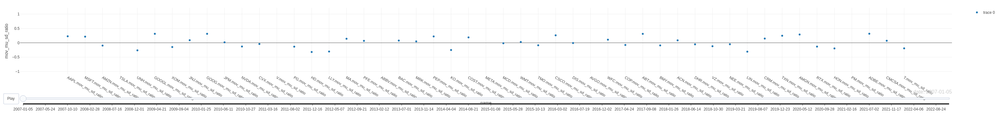

In [50]:
fig

In [19]:
sum(m$daily_avg)

[1] NA